In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots

from datetime import datetime

#pd.set_option('display.max_columns', None)
#pd.set_option("max_rows", None)

In [2]:
! pip install wordcloud
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


In [3]:
listings= pd.read_csv('NY/listings.csv')

In [4]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2595,https://www.airbnb.com/rooms/2595,20210901220703,2021-09-02,Skylit Midtown Castle,"Beautiful, spacious skylit studio in the heart...",Centrally located in the heart of Manhattan ju...,https://a0.muscache.com/pictures/f0813a11-40b2...,2845,https://www.airbnb.com/users/show/2845,Jennifer,2008-09-09,"New York, New York, United States",A New Yorker since 2000! My passion is creatin...,a few days or more,34%,19%,f,https://a0.muscache.com/im/pictures/user/50fc5...,https://a0.muscache.com/im/pictures/user/50fc5...,Midtown,6.0,6.0,"['email', 'phone', 'reviews', 'offline_governm...",t,t,"New York, United States",Midtown,Manhattan,40.75356,-73.98559,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Free street parking"", ""Heating"", ""TV"", ""Dedi...",$150.00,30,1125,30.0,30.0,1125.0,1125.0,30.0,1125.0,NaN,t,5,35,65,340,2021-09-02,48,0,0,2009-11-21,2019-11-04,4.70,4.72,4.62,4.76,4.79,4.86,4.41,NaN,f,3,3,0,0,0.33
1,3831,https://www.airbnb.com/rooms/3831,20210901220703,2021-09-02,"Whole flr w/private bdrm, bath & kitchen(pls r...","Enjoy 500 s.f. top floor in 1899 brownstone, w...",Just the right mix of urban center and local n...,https://a0.muscache.com/pictures/e49999c2-9fd5...,4869,https://www.airbnb.com/users/show/4869,LisaRoxanne,2008-12-07,"New York, New York, United States",Laid-back Native New Yorker (formerly bi-coast...,within a day,50%,86%,f,https://a0.muscache.com/im/users/4869/profile_...,https://a0.muscache.com/im/users/4869/profile_...,Clinton Hill,1.0,1.0,"['email', 'phone', 'reviews', 'offline_governm...",t,t,"Brooklyn, New York, United States",Bedford-Stuyvesant,Brooklyn,40.68494,-73.95765,Entire guest suite,Entire home/apt,3,NaN,1 bath,1.0,3.0,"[""Dedicated workspace"", ""Iron"", ""Stove"", ""Hair...",$76.00,1,730,1.0,1.0,1125.0,1125.0,1.0,1125.0,NaN,t,0,4,9,208,2021-09-02,408,58,0,2015-01-05,2021-06-29,4.46,4.59,4.50,4.79,4.81,4.72,4.65,NaN,f,1,1,0,0,5.03
2,5121,https://www.airbnb.com/rooms/5121,20210901220703,2021-09-02,BlissArtsSpace!,<b>The space</b><br />HELLO EVERYONE AND THANK...,NaN,https://a0.muscache.com/pictures/2090980c-b68e...,7356,https://www.airbnb.com/users/show/7356,Garon,2009-02-03,"New York, New York, United States","I am an artist(painter, filmmaker) and curato...",within a day,100%,NaN,f,https://a0.muscache.com/im/pictures/user/72a61...,https://a0.muscache.com/im/pictures/user/72a61...,Bedford-Stuyvesant,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'off...",t,t,NaN,Bedford-Stuyvesant,Brooklyn,40.68535,-73.95512,Private room in rental unit,Private room,2,NaN,NaN,1.0,1.0,"[""Kitchen"", ""Long term stays allowed"", ""Air co...",$60.00,30,730,30.0,30.0,730.0,730.0,30.0,730.0,NaN,t,30,60,

In [4]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36923 entries, 0 to 36922
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            36923 non-null  int64  
 1   listing_url                                   36923 non-null  object 
 2   scrape_id                                     36923 non-null  int64  
 3   last_scraped                                  36923 non-null  object 
 4   name                                          36910 non-null  object 
 5   description                                   35710 non-null  object 
 6   neighborhood_overview                         22510 non-null  object 
 7   picture_url                                   36923 non-null  object 
 8   host_id                                       36923 non-null  int64  
 9   host_url                                      36923 non-null 

In [5]:
# Drop columns that are not to be included in the analysis
listings = listings.drop(['scrape_id','last_scraped','picture_url','host_id','host_url','host_name',
                            'host_thumbnail_url','host_picture_url','host_neighbourhood', 
                            'host_listings_count', 'bathrooms','minimum_minimum_nights',
                            'maximum_minimum_nights', 'minimum_maximum_nights','maximum_maximum_nights', 'minimum_nights_avg_ntm',
                            'maximum_nights_avg_ntm', 'calendar_updated','calendar_last_scraped','number_of_reviews_ltm', 
                            'number_of_reviews_l30d', 'license'], axis = 1)

# Data Cleaning

# Features related to listings

In [6]:
listings.id.count()

36923

In [8]:
listings.id.nunique() # All id values are unique -no duplicates

36923

In [9]:
pd.Series(listings.listing_url).nunique() # no duplicates

36923

In [10]:
listings.name.isnull().sum()

13

In [11]:
listings[listings.name.isnull()] #

,id,listing_url,name,description,neighborhood_overview,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
2129,2232600,https://www.airbnb.com/rooms/2232600,NaN,NaN,NaN,2014-01-17,"New York, New York, United States",NaN,NaN,NaN,NaN,f,1.0,"['email', 'phone', 'reviews', 'kba']",t,t,NaN,East Village,Manhattan,40.73192,-73.98819,Entire rental unit,Entire home/apt,2,NaN,NaN,NaN,"[""Kitchen"", ""Smoke alarm"", ""Heating"", ""TV"", ""S...",$200.00,30,365,t,9,17,25,279,28,2014-06-06,2015-06-08,4.74,4.94,4.65,4.75,4.94,4.88,4.88,f,1,1,0,0,0.32
3351,4209595,https://www.airbnb.com/rooms/4209595,NaN,NaN,NaN,2014-08-29,"New York, New York, United States",Hello! We are a kindergarten teacher and a fin...,NaN,NaN,NaN,f,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",t,t,NaN,Greenwich Village,Manhattan,40.73323,-73.99294,Entire rental unit,Entire home/apt,4,1 bath,1.0,1.0,"[""Kitchen"", ""Smoke alarm"", ""Heating"", ""Carbon ...",$225.00,30,1125,t,0,0,0,0,1,2015-01-01,2015-01-01,5.00,5.00,5.00,5.00,5.00,5.00,5.00,f,1,1,0,0,0.01
3460,4370230,https://www.airbnb.com/rooms/4370230,NaN,Beautiful 1BR apartment in the heart of Nolita...,NaN,2014-10-18,"Paris, Île-de-France, France",NaN,NaN,NaN,NaN,f,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",t,t,NaN,Nolita,Manhattan,40.72100,-73.99536,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Kitchen"", ""Smoke alarm"", ""Heating"", ""Carbon ...",$215.00,30,1125,t,0,0,0,0,5,2014-11-30,2015-09-27,5.00,5.00,4.80,5.00,4.80,5.00,4.80,f,1,1,0,0,0.06
3636,4581788,https://www.airbnb.com/rooms/4581788,NaN,NaN,NaN,2014-09-21,"New York, New York, United States",NaN,NaN,NaN,NaN,f,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",t,t,NaN,Williamsburg,Brooklyn,40.71370,-73.94378,Private room in rental unit,Private room,1,2 baths,1.0,1.0,"[""Wifi"", ""Long term stays allowed"", ""Shampoo"",...",$150.00,30,1125,f,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN
3821,4756856,https://www.airbnb.com/rooms/4756856,NaN,"Sunny bedroom in Castlebraid, Bushwick! I shar...",NaN,2012-02-29,"New York, New York, United States",My name is Carolina. I´m a peruvian artist bas...,NaN,NaN,NaN,f,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",t,t,NaN,Bushwick,Brooklyn,40.69869,-73.92852,Private room in rental unit,Private room,1,2 baths,1.0,1.0,"[""Kitchen"", ""Washer"", ""Gym"", ""Heating"", ""Air c...",$70.00,30,1125,t,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN
3842,4774658,https://www.airbnb.com/rooms/4774658,NaN,Room available (sublet) Jan.<br />Price very n...,NaN,2014-12-08,"New York, New York, United States",NaN,NaN,NaN,NaN,f,1.0,"['email', 'phone']",t,f,NaN,Washington Heights,Manhattan,40.85111,-73.93009,Private room in rental unit,Private room,1,1 bath,1.0,1.0,"[""Kitchen"", ""Washer"", ""Smoke alarm"", ""Heating""...",$40.00,30,1125,t,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN
5150,6782407,https://www.airbnb.com/rooms/6782407,NaN,A cute and cozy private room in East Williamsb...,There is a laundromat and a deli around the co...,2015-04-13,"Taipei, Taiwan",This is Huei from Taiwan. \n\nI studied and wo...,NaN,NaN,NaN,f,1.0,"['ema

In [7]:
listings.drop('name', axis=1, inplace =True)

In [194]:
listings.description.isnull().value_counts()

False    35710
True      1213
Name: description, dtype: int64

In [14]:
listings.description[1]

'Enjoy 500 s.f. top floor in 1899 brownstone, w/ wood & ceramic flooring throughout, roomy bdrm, & upgraded kitchen & bathroom.\xa0 This space is unique but one of the few legal AirBnbs with a totally private bedroom, private full bathroom and private eat-in kitchen, SO PLEASE READ "THE SPACE" CAREFULLY.\xa0 It\'s sunny & loaded with everything you need! Your floor, and the common staircase/hallway/entryway are cleaned/sanitized per Airbnb\'s Enhanced Cleaning Protocol.<br /><br /><b>The space</b><br />We host on the entire top floor of our double-duplex brownstone in Clinton Hill on Gates near Classon Avenue - (7 blocks to C train, 5 blocks to G train, minutes to downtown Brooklyn & lower Manhattan).\xa0 It is not an apartment in the traditional sense, it is more of an efficiency set-up and is TOTALLY LEGAL with all short-term rental laws. The top floor for our guests consists of a sizable bedroom, full bath and eat-in kitchen for your exclusive use - you get the amenities of a privat

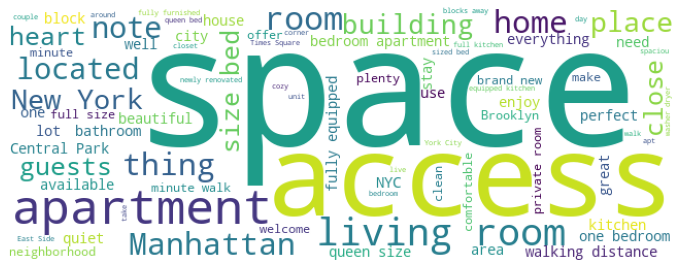

In [15]:
my_stopwords = ["br",'Guest','will','b','License number']+list(STOPWORDS)
words = " ".join(str(w) for w in listings.description)
plt.subplots(figsize=(12,6))
wordcloud = WordCloud(stopwords =my_stopwords, background_color='white',width=650,height=250,max_words=80).generate(words)
plt.imshow(wordcloud)
plt.axis('off')
plt.savefig('name.png')
plt.show()


In [8]:
#Writing more detail description about the rental might affect guest's decision about the house. So  
listings['description_len']= listings['description'].str.len()

In [9]:
listings.description_len.fillna(0, inplace = True)

In [10]:
listings.drop('description', axis =1 , inplace=True)

In [198]:
listings.neighborhood_overview.isnull().value_counts()

False    22510
True     14413
Name: neighborhood_overview, dtype: int64

In [11]:
#Longer neighborhood overview might mean there are more to do around the house which might affect guest's decision
listings['neighborhood_overview_len'] = listings.neighborhood_overview.str.len()

In [12]:
listings['neighborhood_overview_len'].fillna(0, inplace =True)

In [13]:
listings['neighborhood_overview_len'].isnull().value_counts()

False    36923
Name: neighborhood_overview_len, dtype: int64

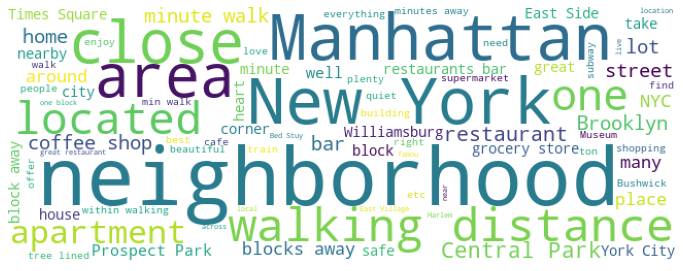

In [23]:
my_stopwords = ["br",'Guest','will','b','License number','nan']+list(STOPWORDS)
words2 = " ".join(str(w) for w in listings.neighborhood_overview)
plt.subplots(figsize=(12,6))
wordcloud2 = WordCloud(stopwords =my_stopwords, background_color='white',width=650,height=250,max_words=80).generate(words2)
plt.imshow(wordcloud2)
plt.axis('off')
plt.savefig('name2.png')
plt.show()


# Features related to host

In [202]:
listings.host_since.isnull().value_counts() #

False    36812
True       111
Name: host_since, dtype: int64

In [203]:
listings.host_since.head()

0    2008-09-09
1    2008-12-07
2    2009-02-03
3    2009-02-03
4    2009-03-03
Name: host_since, dtype: object

In [14]:
listings.dropna(subset=['host_since'], inplace =True) #Drop na -

In [206]:
listings.host_since.isnull().value_counts() #

False    36812
Name: host_since, dtype: int64

In [207]:
listings.host_location.isnull().value_counts()

False    36714
True        98
Name: host_location, dtype: int64

In [15]:
listings.dropna(subset=['host_location'], inplace = True) #Drop na

In [209]:
listings.host_location.value_counts().head() # Most hosts are located in USA

New York, New York, United States         21095
US                                         4237
Brooklyn, New York, United States          3634
Queens, New York, United States            1713
Los Angeles, California, United States      268
Name: host_location, dtype: int64

In [210]:
listings.host_location.value_counts().tail() # There are hosts outside USA

Glasgow, Scotland, United Kingdom          1
Dallas, Georgia, United States             1
Lincoln, Nebraska, United States           1
Brookline, Massachusetts, United States    1
Upland, California, United States          1
Name: host_location, dtype: int64

In [16]:
listings['host_state_NY']= listings.host_location.apply(lambda s: 1 if 'New York' in s else 0)

In [17]:
listings['host_state_NY'].value_counts()

1    27606
0     9108
Name: host_state_NY, dtype: int64

In [213]:
listings.host_about.isnull().value_counts()

False    21632
True     15082
Name: host_about, dtype: int64

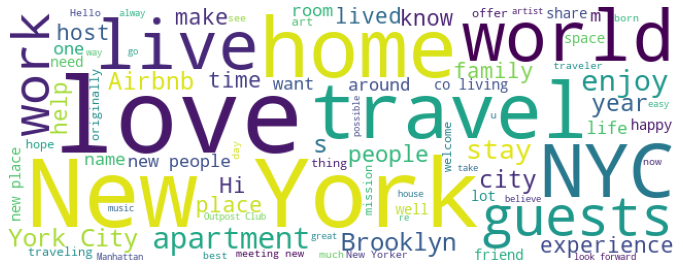

In [36]:
my_stopwords = ["br",'Guest','will','b','License number','nan']+list(STOPWORDS)
words3 = " ".join(str(w) for w in listings.host_about)
plt.subplots(figsize=(12,6))
wordcloud3 = WordCloud(stopwords =my_stopwords, background_color='white',width=650,height=250,max_words=80).generate(words3)
plt.imshow(wordcloud3)
plt.axis('off')
plt.savefig('name3.png')
plt.show()

In [18]:
listings['host_about_len'] = listings.host_about.str.len()

In [19]:
listings['host_about_len'].fillna(0, inplace =True)

In [20]:
listings.drop('host_about', axis =1, inplace = True)

In [217]:
listings.host_response_time.isnull().value_counts() 
# Too many missing numbers! Missing data points will be categorized as unknown

False    21133
True     15581
Name: host_response_time, dtype: int64

In [21]:
listings.host_response_time.fillna("unknown", inplace=True)

In [22]:
listings.host_response_time.value_counts() 

unknown               15581
within an hour        10757
within a few hours     4734
within a day           3563
a few days or more     2079
Name: host_response_time, dtype: int64

In [220]:
listings.host_response_rate.isnull().value_counts() 
# Too many missing numbers!

False    21133
True     15581
Name: host_response_rate, dtype: int64

(array([ 1188.,   156.,   213.,   394.,   118.,   365.,   568.,   629.,
         1392., 16110.]),
 array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.]),
 <BarContainer object of 10 artists>)

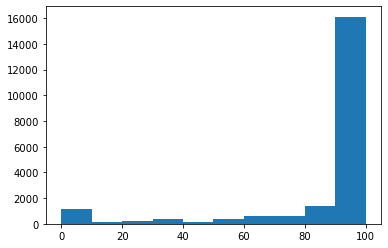

In [23]:
# Removing the % sign from the host_response_rate
listings.host_response_rate = listings.host_response_rate.str[:-1].astype('float64')
plt.hist(listings.host_response_rate)

In [222]:
listings.host_response_rate.value_counts().head()

100.0    11952
0.0       1148
99.0       845
90.0       825
97.0       740
Name: host_response_rate, dtype: int64

Response rate will be divoded into 5 groups: 100% response rate, 85-99% response rate, 50-84% response rate, 0-49% response rate and unknown for nan values.

In [24]:
listings['host_response_rate_per'] = pd.cut(listings.host_response_rate, 
                               bins=[0, 50, 85, 99, 100], 
                               labels=['0-49%', '50-84%', '85-99%', '100%'], 
                               include_lowest=True)

listings.host_response_rate_per = listings.host_response_rate_per.astype('str')
listings.host_response_rate_per.fillna("unknown", inplace =True)

In [224]:
listings.host_response_rate_per.value_counts()

unknown    15581
100%       11952
85-99%      4776
0-49%       2360
50-84%      2045
Name: host_response_rate_per, dtype: int64

In [25]:
listings.drop('host_response_rate',axis =1,inplace =True)

In [226]:
listings.host_acceptance_rate.isnull().value_counts()
# Too many missing numbers! I prefer to eliminate this feature instead of manipulating which might have 
# a big effect in future analysis. In addition, host_response__rate and host_acceptance_rate might be 
#correlated with each other.


False    21770
True     14944
Name: host_acceptance_rate, dtype: int64

In [26]:
listings.drop('host_acceptance_rate', axis=1, inplace =True)

In [228]:
listings.host_is_superhost.isnull().value_counts()

False    36714
Name: host_is_superhost, dtype: int64

In [229]:
listings.host_is_superhost.value_counts()

f    30107
t     6607
Name: host_is_superhost, dtype: int64

In [27]:
# Substitute true/false with 1/0
listings.host_is_superhost.replace({'f': 0, 't': 1}, inplace=True)

In [231]:
listings[['host_total_listings_count']].describe() #

,host_total_listings_count
count,36714.000000
mean,32.852536
std,213.943499
min,0.000000
25%,1.000000
50%,1.000000
75%,3.000000
max,5069.000000


(array([3.6293e+04, 3.0000e+00, 6.2000e+01, 2.9700e+02, 4.5000e+01,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4000e+01]),
 array([   0. ,  506.9, 1013.8, 1520.7, 2027.6, 2534.5, 3041.4, 3548.3,
        4055.2, 4562.1, 5069. ]),
 <BarContainer object of 10 artists>)

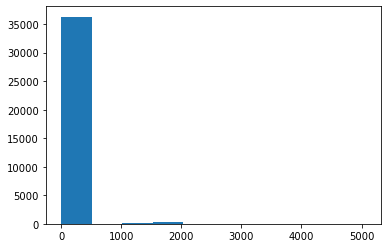

In [232]:
plt.hist(listings['host_total_listings_count'])

In [233]:
np.percentile(listings['host_total_listings_count'],80)

4.0

In [28]:
listings['host_proffesional']= listings.host_total_listings_count.apply(lambda s: 1 if s >5 else 0) # Hosts with many listings can belong to a location rental company

In [235]:
listings.host_proffesional.value_counts()

0    30506
1     6208
Name: host_proffesional, dtype: int64

In [236]:
listings.host_verifications.isnull().value_counts()

False    36714
Name: host_verifications, dtype: int64

In [237]:
listings.host_verifications.head(5)

0    ['email', 'phone', 'reviews', 'offline_governm...
1    ['email', 'phone', 'reviews', 'offline_governm...
2    ['email', 'phone', 'facebook', 'reviews', 'off...
3                        ['email', 'phone', 'reviews']
4            ['email', 'phone', 'facebook', 'reviews']
Name: host_verifications, dtype: object

In [29]:
listings['host_verifications_count'] = listings.host_verifications.apply(lambda s: len(s.split(', ')))

In [239]:
listings['host_verifications_count'].value_counts()

6     7055
5     6693
4     5655
7     4923
2     3959
8     2799
3     2736
9     1505
1     1017
10     306
11      58
12       7
13       1
Name: host_verifications_count, dtype: int64

In [240]:
listings.host_has_profile_pic.isnull().value_counts()

False    36714
Name: host_has_profile_pic, dtype: int64

In [30]:
# Substitute true/false with 1/0
listings.host_has_profile_pic.replace({'f': 0, 't': 1}, inplace=True)

In [242]:
listings.host_identity_verified.isnull().value_counts()

False    36714
Name: host_identity_verified, dtype: int64

In [31]:
# Substitute true/false with 1/0
listings.host_identity_verified.replace({'f': 0, 't': 1}, inplace=True)

# Features about neighbourhood

In [244]:
listings[['neighbourhood','neighbourhood_cleansed', 'neighbourhood_group_cleansed']].head()

,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed
0,"New York, United States",Midtown,Manhattan
1,"Brooklyn, New York, United States",Bedford-Stuyvesant,Brooklyn
2,NaN,Bedford-Stuyvesant,Brooklyn
3,NaN,Sunset Park,Brooklyn
4,"New York, United States",Midtown,Manhattan


In [245]:
listings.neighbourhood_group_cleansed.value_counts().sort_values(ascending = False)

Manhattan        16155
Brooklyn         14296
Queens            4931
Bronx             1022
Staten Island      310
Name: neighbourhood_group_cleansed, dtype: int64

In [246]:
listings.neighbourhood_group_cleansed.isnull().value_counts()

False    36714
Name: neighbourhood_group_cleansed, dtype: int64

In [247]:
listings.neighbourhood_cleansed.isnull().value_counts()

False    36714
Name: neighbourhood_cleansed, dtype: int64

In [32]:
listings = listings.rename(columns={'neighbourhood_cleansed': 'neighbourhood', 'neighbourhood_group_cleansed': 'region'})

In [35]:
listings.to_pickle("./dummy.pkl")

# Features about the rental

In [329]:
listings.property_type.isnull().value_counts()

False    36714
Name: property_type, dtype: int64

In [251]:
listings.property_type.value_counts()

Entire rental unit                     15502
Private room in rental unit            11391
Private room in residential home        1858
Private room in townhouse               1126
Entire residential home                 1078
Entire condominium (condo)              1047
Entire loft                              599
Entire townhouse                         581
Room in hotel                            576
Shared room in rental unit               431
Room in boutique hotel                   425
Private room in condominium (condo)      399
Private room in loft                     288
Entire guest suite                       288
Entire serviced apartment                283
Private room in serviced apartment       107
Private room in guest suite              104
Shared room in residential home           63
Entire guesthouse                         52
Private room in bed and breakfast         46
Entire place                              37
Room in aparthotel                        37
Private ro

In [252]:
listings.room_type.isnull().value_counts()

False    36714
Name: room_type, dtype: int64

In [253]:
listings.room_type.value_counts() # room_type is generalized version of the property_type
#I will eliminate the property_type from future analysis

Entire home/apt    19599
Private room       16282
Shared room          575
Hotel room           258
Name: room_type, dtype: int64

In [36]:
listings.drop('property_type', axis=1, inplace=True)

In [255]:
listings.accommodates.isnull().value_counts()

False    36714
Name: accommodates, dtype: int64

In [256]:
listings.accommodates.value_counts().sort_values(ascending =True)

15       15
14       15
0        22
13       23
11       24
9        54
12       93
16      101
10      162
7       321
8       505
5      1480
6      1679
3      3703
4      5630
1      6162
2     16725
Name: accommodates, dtype: int64

In [257]:
listings[listings.accommodates ==0]['listing_url'] # Accommodates  == 0 are all hotel rooms

27068    https://www.airbnb.com/rooms/42830099
27250    https://www.airbnb.com/rooms/43035720
27302    https://www.airbnb.com/rooms/43078550
27303    https://www.airbnb.com/rooms/43078552
27402    https://www.airbnb.com/rooms/43205598
27410    https://www.airbnb.com/rooms/43212721
27428    https://www.airbnb.com/rooms/43247386
27429    https://www.airbnb.com/rooms/43247472
27430    https://www.airbnb.com/rooms/43247631
28450    https://www.airbnb.com/rooms/44567521
28621    https://www.airbnb.com/rooms/45063489
29071    https://www.airbnb.com/rooms/45494997
29395    https://www.airbnb.com/rooms/45789481
29659    https://www.airbnb.com/rooms/46059074
29689    https://www.airbnb.com/rooms/46087899
29854    https://www.airbnb.com/rooms/46251446
29930    https://www.airbnb.com/rooms/46336133
30331    https://www.airbnb.com/rooms/46723973
30336    https://www.airbnb.com/rooms/46725838
31568    https://www.airbnb.com/rooms/48089897
31886    https://www.airbnb.com/rooms/48325676
31984    http

In [37]:
listings['accommodates']=listings['accommodates'].replace(0, 2)


In [336]:
listings.accommodates.value_counts().sort_values(ascending=True)

14       15
15       15
13       23
11       24
9        54
12       93
16      101
10      162
7       321
8       505
5      1480
6      1679
3      3703
4      5630
1      6162
2     16747
Name: accommodates, dtype: int64

In [38]:
listings['accomodates_level'] = pd.qcut(listings['accommodates'].rank(method = 'first'),3,['low','medium','high'])

In [39]:
listings.accomodates_level.value_counts()

low       12238
medium    12238
high      12238
Name: accomodates_level, dtype: int64

In [339]:
listings.bathrooms_text.isnull().value_counts()

False    36610
True       104
Name: bathrooms_text, dtype: int64

In [340]:
listings.bathrooms_text.value_counts()

1 bath               19165
1 shared bath         9064
1 private bath        2345
2 baths               2159
2 shared baths        1080
1.5 baths              998
1.5 shared baths       675
2.5 baths              288
3 baths                187
0 shared baths         133
3 shared baths         109
2.5 shared baths        90
3.5 baths               77
4 baths                 57
0 baths                 47
Half-bath               36
4.5 baths               20
4 shared baths          16
Shared half-bath        16
Private half-bath       14
5 baths                  9
6 baths                  6
5.5 baths                5
8 baths                  3
5 shared baths           2
3.5 shared baths         2
15.5 baths               1
6.5 baths                1
6 shared baths           1
7.5 baths                1
4.5 shared baths         1
7 baths                  1
10 baths                 1
Name: bathrooms_text, dtype: int64

In [341]:
listings[listings.bathrooms_text == '1.5 shared baths']['listing_url'] 
#shared bathrooms are either rooms in a house or in a hostel

49          https://www.airbnb.com/rooms/20717
50          https://www.airbnb.com/rooms/20724
91          https://www.airbnb.com/rooms/44096
96          https://www.airbnb.com/rooms/45556
188         https://www.airbnb.com/rooms/80493
223        https://www.airbnb.com/rooms/110576
287        https://www.airbnb.com/rooms/170761
309        https://www.airbnb.com/rooms/195123
658        https://www.airbnb.com/rooms/476983
741        https://www.airbnb.com/rooms/550653
763        https://www.airbnb.com/rooms/573671
794        https://www.airbnb.com/rooms/600775
990        https://www.airbnb.com/rooms/774791
1078       https://www.airbnb.com/rooms/819956
1122       https://www.airbnb.com/rooms/848718
1141       https://www.airbnb.com/rooms/855542
1173       https://www.airbnb.com/rooms/886808
1240       https://www.airbnb.com/rooms/957642
1305      https://www.airbnb.com/rooms/1030254
1313      https://www.airbnb.com/rooms/1040182
1363      https://www.airbnb.com/rooms/1121502
1368      htt

In [40]:
listings.bathrooms_text = listings.bathrooms_text.astype('str')
listings['bathroom_type'] = listings.bathrooms_text.apply(lambda s: 0 if 'shared'  in s.lower().split(' ')  else 1)
#If the bathroom is private, type is 1. If it is a shared bathroom, type is zero.

In [343]:
listings.bathroom_type.value_counts()

1    25525
0    11189
Name: bathroom_type, dtype: int64

In [41]:
listings['bathrooms']=listings.bathrooms_text.apply(lambda s:0.5 if 'half-bath'  in s.lower().split(' ') else s.split(' ')[0] )

In [42]:
#listings.bathrooms = listings.bathrooms.astype('str')
listings['bathrooms']=listings['bathrooms'].replace('nan',0, inplace =True)
listings.bathrooms.value_counts()

C:\Users\12157\anaconda3\envs\metis\lib\site-packages\pandas\core\series.py:4509: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().replace(


Series([], Name: bathrooms, dtype: int64)

In [351]:
#listings.drop('bathrooms',axis=1,inplace=True)

In [353]:
listings.bedrooms.isnull().value_counts()

False    32790
True      3924
Name: bedrooms, dtype: int64

In [354]:
listings.bedrooms.value_counts()

1.0     25315
2.0      5163
3.0      1667
4.0       476
5.0       110
6.0        29
8.0        11
7.0         9
9.0         4
10.0        3
14.0        1
11.0        1
13.0        1
Name: bedrooms, dtype: int64

In [43]:
listings.to_pickle("./dummy.pkl")

In [44]:
listings['bedrooms']=listings['bedrooms'].fillna(value =1) #Assumption: There should be at least one room or common room as a bedroom


In [357]:
listings.bedrooms.isnull().value_counts()

False    36714
Name: bedrooms, dtype: int64

In [358]:
listings.beds.isnull().value_counts()

False    36105
True       609
Name: beds, dtype: int64

In [359]:
listings.beds.value_counts()

1.0     22268
2.0      7653
3.0      2719
0.0      1499
4.0      1187
5.0       382
6.0       200
7.0        81
8.0        50
9.0        29
10.0       11
12.0        8
11.0        6
13.0        4
16.0        2
15.0        2
17.0        1
42.0        1
24.0        1
21.0        1
Name: beds, dtype: int64

In [45]:
listings['beds']=listings['beds'].fillna(value = listings.bedrooms) #Assumption: Each bedroom has at least bed 

In [361]:
listings.beds.isnull().value_counts()

False    36714
Name: beds, dtype: int64

In [362]:
listings.amenities.isnull().value_counts()

False    36714
Name: amenities, dtype: int64

In [363]:
listings.amenities[:1].values

array(['["Free street parking", "Heating", "TV", "Dedicated workspace", "Cleaning before checkout", "Keypad", "Luggage dropoff allowed", "Stove", "Kitchen", "Baking sheet", "Air conditioning", "Oven", "Essentials", "Coffee maker", "Smoke alarm", "Fire extinguisher", "Cooking basics", "Wifi", "Ethernet connection", "Bathtub", "Iron", "Paid parking off premises", "Hair dryer", "Long term stays allowed", "Hot water", "Bed linens", "Extra pillows and blankets", "Hangers", "Carbon monoxide alarm", "Refrigerator", "Dishes and silverware"]'],
      dtype=object)

In [364]:
listings.amenities.value_counts().head()

["Long term stays allowed"]                                                                                                                                                                                                                                                                                                                                                                                                               137
["Dedicated workspace", "Iron", "Hair dryer", "Fire extinguisher", "Building staff", "Essentials", "Heating", "Shower gel", "Body soap", "Air conditioning", "TV", "Smoke alarm", "Hot water", "Hangers", "Wifi", "Luggage dropoff allowed", "Lock on bedroom door", "Carbon monoxide alarm", "First aid kit", "Long term stays allowed", "Conditioner", "Bed linens", "Shampoo"]                                                          50
["Gym", "Heating", "Dedicated workspace", "Cable TV", "Stove", "Kitchen", "Dryer", "Air conditioning", "Oven", "Essentials", "Coffee maker",

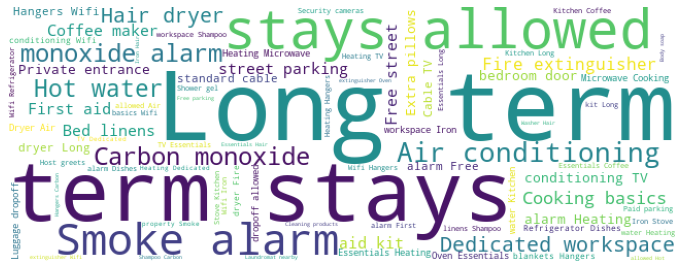

In [119]:
#Amenities WordCloud
my_stopwords = ["br",'Guest','will','b','License number','nan']+list(STOPWORDS)
words4 = " ".join(str(w) for w in listings.amenities)
plt.subplots(figsize=(12,6))
wordcloud4 = WordCloud(stopwords =my_stopwords, background_color='white',width=650,height=250,max_words=80).generate(words4)
plt.imshow(wordcloud4)
plt.axis('off')
plt.savefig('name4.png')
plt.show()

New features to distinguish most critical amenities, and amenities_number to represent the total number of amenities.

In [46]:
listings['Parking'] = listings.amenities.apply(lambda s: 1 if 'parking'  in s.lower().split(' ') else 0 )
listings['Kitchen'] = listings.amenities.apply(lambda s: 1 if 'kitchen'  in s.lower().split(' ') else 0 )
listings['TV'] = listings.amenities.apply(lambda s: 1 if 'TV' in s.lower().split(' ') else 0)
listings['Wifi'] = listings.amenities.apply(lambda s: 1 if 'Wifi' in s.lower().split(' ') else 0)

listings['amenities_count'] = listings.amenities.apply(lambda s: len(s.lower().split(' ')))

# Features related to the rental agreement

In [366]:
listings.price.isnull().value_counts()

False    36714
Name: price, dtype: int64

In [367]:
listings.minimum_nights.isnull().value_counts()

False    36714
Name: minimum_nights, dtype: int64

In [368]:
listings.minimum_nights.value_counts().head()

30    21062
1      4327
2      3313
3      2616
5      1011
Name: minimum_nights, dtype: int64

In [47]:
#short-term stays (less than 30 nights at a time) in Los Angeles.
listings['short_term_rental'] = listings.minimum_nights.apply(lambda s: 1 if s <30 else 0)

In [370]:
listings.maximum_nights.isnull().value_counts()

False    36714
Name: maximum_nights, dtype: int64

In [371]:
listings.maximum_nights.value_counts().sort_values(ascending = False).head(10)

1125    19529
365      2962
30       2618
90       1197
60       1094
28       1054
180       793
31        554
14        477
7         424
Name: maximum_nights, dtype: int64

There are multiple columns related minimum and maximum night stays, I assume the most relevant one for short term rentals is minimum_nights and this should be less than 30 days in LA otherwise it is considered long term rental. 


In [244]:
#listings.drop('maximum_nights',axis =1, inplace = True)

In [49]:
listings.to_pickle("./dummy1.pkl")

In [305]:
listings[['availability_30', 'availability_60', 'availability_90','availability_365']].describe()

,availability_30,availability_60,availability_90,availability_365
count,36714.000000,36714.000000,36714.000000,36714.000000
mean,6.106935,15.845372,27.772948,123.587242
std,9.940232,21.355636,33.590831,138.278906
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,3.000000,61.000000
75%,9.000000,31.000000,60.000000,264.000000
max,30.000000,60.000000,90.000000,365.000000


In [398]:
listings.availability_365.isnull().value_counts()

False    36714
Name: availability_365, dtype: int64

In [ ]:
#listings[listings.availability_365 ==0]

 # Features related to guest experiences

In [374]:
listings.number_of_reviews.isnull().value_counts()

False    36714
Name: number_of_reviews, dtype: int64

In [375]:
listings.number_of_reviews.describe()

count    36714.000000
mean        23.073133
std         49.494476
min          0.000000
25%          1.000000
50%          4.000000
75%         20.000000
max       1006.000000
Name: number_of_reviews, dtype: float64

(array([3.434e+04, 1.735e+03, 4.750e+02, 1.140e+02, 2.900e+01, 1.600e+01,
        3.000e+00, 1.000e+00, 0.000e+00, 1.000e+00]),
 array([   0. ,  100.6,  201.2,  301.8,  402.4,  503. ,  603.6,  704.2,
         804.8,  905.4, 1006. ]),
 <BarContainer object of 10 artists>)

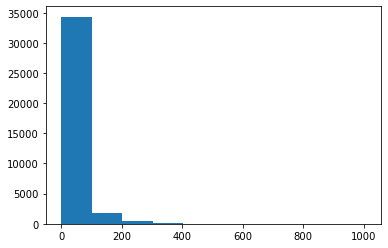

In [376]:
plt.hist(listings.number_of_reviews)

In [312]:
#Too many null values in review_scores
listings[['review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36714 entries, 0 to 36922
Data columns (total 7 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   review_scores_rating         27548 non-null  float64
 1   review_scores_accuracy       26924 non-null  float64
 2   review_scores_cleanliness    26935 non-null  float64
 3   review_scores_checkin        26917 non-null  float64
 4   review_scores_communication  26928 non-null  float64
 5   review_scores_location       26913 non-null  float64
 6   review_scores_value          26913 non-null  float64
dtypes: float64(7)
memory usage: 2.2 MB


In [313]:
listings[['review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value']].describe()

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,27548.000000,26924.000000,26935.000000,26917.000000,26928.000000,26913.000000,26913.000000
mean,4.578882,4.747635,4.610740,4.817785,4.814444,4.753379,4.651238
std,0.853072,0.494129,0.576025,0.438775,0.456560,0.415395,0.514225
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.570000,4.710000,4.500000,4.820000,4.820000,4.670000,4.560000
50%,4.820000,4.900000,4.800000,4.960000,4.980000,4.880000,4.790000
75%,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


All review scores are highly positive scores. There is no scores less that 4.5 out of 5. On the other hand, each score metric has about 7000-8000 missing values. Thus, I might eliminate these features during modeling.

In [314]:
#listings.drop(['review_scores_rating', 'review_scores_accuracy','review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location','review_scores_value'],axis =1, inplace =True)



In [377]:
listings.reviews_per_month.isnull().value_counts()

False    27548
True      9166
Name: reviews_per_month, dtype: int64

In [400]:
listings.reviews_per_month.describe() 

count    27548.000000
mean         1.452148
std          4.051231
min          0.010000
25%          0.110000
50%          0.440000
75%          1.510000
max        163.190000
Name: reviews_per_month, dtype: float64

(array([6037., 3414., 2363., 1432., 1218., 1009.,  742.,  649.,  659.,
         581.,  926.,  515.,  351.,  395.,  307.,  336.,  355.,  281.,
         321.,  265.,  467.,  254.,  275.,  202.,  169.,  198.,  171.,
         199.,  166.,  252.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
        1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5,
        2.6, 2.7, 2.8, 2.9, 3. ]),
 <BarContainer object of 30 artists>)

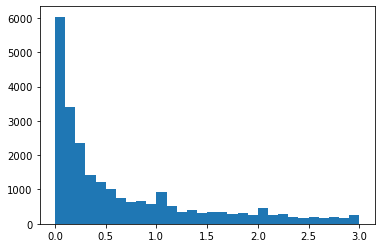

In [317]:
plt.hist(listings.reviews_per_month, bins=30, range =(0,3))

In [139]:
listings[listings.reviews_per_month.isnull()]

,id,listing_url,neighborhood_overview,host_since,host_location,host_response_time,host_is_superhost,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood,region,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,description_len,neighborhood_overview_len,host_state_NY,host_about_len,host_response_rate_per,host_proffesional,host_verifications_count,accomodates_level,bathroom_type,bathrooms,Parking,Kitchen,TV,Wifi,amenities_count,short_term_rental
8,6872,https://www.airbnb.com/rooms/6872,This sweet Harlem sanctuary is a 10-20 minute ...,2009-05-07,"New York, New York, United States",unknown,0,0.0,"['email', 'phone', 'reviews', 'offline_governm...",1,1,"New York, United States",East Harlem,Manhattan,40.801070,-73.942550,Private room,1,1 shared bath,1.0,1.0,"[""Dedicated workspace"", ""Dryer"", ""Hot water"", ...",$65.00,30,180,t,30,60,90,365,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,2,0,2,0,NaN,1000.0,275.0,1,233.0,unknown,0,8,low,0,1,1,0,0,0,41,0
12,7750,https://www.airbnb.com/rooms/7750,NaN,2009-05-20,"Brooklyn, New York, United States",within a few hours,0,2.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",1,1,NaN,East Harlem,Manhattan,40.796070,-73.949490,Private room,1,1 shared bath,2.0,2.0,"[""Kitchen"", ""Long term stays allowed"", ""Air co...",$96.00,30,365,t,28,58,88,178,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,2,0,2,0,NaN,1000.0,0.0,1,47.0,85-99%,0,6,low,0,1,0,0,0,0,16,0
20,11943,https://www.airbnb.com/rooms/11943,NaN,2009-10-12,"New York, New York, United States",unknown,0,1.0,['phone'],1,0,NaN,Flatbush,Brooklyn,40.637020,-73.963270,Private room,1,1 bath,1.0,2.0,"[""Kitchen"", ""Washer"", ""Heating"", ""Dryer"", ""Air...",$150.00,30,730,f,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN,263.0,0.0,1,0.0,unknown,0,1,low,1,1,0,0,0,0,12,0
98,45935,https://www.airbnb.com/rooms/45935,NaN,2010-08-17,US,unknown,0,1.0,"['email', 'phone']",1,0,NaN,Mott Haven,Bronx,40.806350,-73.922010,Private room,1,1 shared bath,1.0,1.0,"[""Dedicated workspace"", ""Breakfast"", ""First ai...",$60.00,30,40,t,23,53,83,83,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN,596.0,0.0,0,0.0,unknown,0,2,low,0,1,0,0,0,0,22,0
105,51438,https://www.airbnb.com/rooms/51438,NaN,2010-09-16,"New York, New York, United States",unknown,0,2.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",1,1,NaN,Upper East Side,Manhattan,40.774490,-73.953080,Private room,1,1 bath,1.0,1.0,"[""Kitchen"", ""Washer"", ""Heating"", ""Dryer"", ""Air...",$130.00,14,31,t,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,2,0,2,0,NaN,630.0,0.0,1,159.0,unknown,0,5,low,1,1,0,0,0,0,17,1
111,54466,https://www.airbnb.com/rooms/54466,NaN,2010-10-05,"New York, New York, United States",unknown,0,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",1,1,NaN,Harlem,Manhattan,40.802550,-73.958030,Private room,2,1 bath,1.0,1.0,"[""Refrigerator"", ""Cooking basics"", ""Dryer"", ""S...",$200.00,30,60,t,30,60,90,365,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN,782.0,0.0,1,0.0,unknown,0,5,low,1,1,0,0,0,0,34,0
144,63588,https://www.airbnb.com/rooms/63588,My home sits on a tree lined street across fro...,2010-11-22,"New York, New York, United States",within an hour,0,7.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",1,1,"Bronx, New York, United States",Clason Point,Bronx,40.811610,-73.854990,Private room,3,1 shared bath,1.0,2.0,"[""Dedicated workspace"", ""Iron"", ""Stove

In [50]:
listings['reviews_per_month']=listings['reviews_per_month'].fillna(0)

In [402]:
listings['reviews_per_month'].isnull().value_counts()

False    36714
Name: reviews_per_month, dtype: int64

In [270]:
#listings = listings[(listings['reviews_per_month']<=7)]

In [382]:
listings.reviews_per_month.describe()

count    36714.000000
mean         1.089606
std          3.565091
min          0.000000
25%          0.010000
50%          0.190000
75%          1.000000
max        163.190000
Name: reviews_per_month, dtype: float64

In [383]:
listings.reviews_per_month.sort_values(ascending = False).head(10)

33120    163.19
26896    159.00
14329    157.06
21365    117.43
27985    111.00
33053    100.68
27559     82.00
33117     80.81
30579     80.00
22616     75.00
Name: reviews_per_month, dtype: float64

In [384]:
#listings[listings.reviews_per_month==80]

In [385]:
listings.first_review.isnull().value_counts()

False    27548
True      9166
Name: first_review, dtype: int64

In [388]:
#listings.drop('first_review',axis=1, inplace =True) #This is used to calculate number_of_reviews_per_month. 

In [387]:
listings.last_review.isnull().value_counts()

False    27548
True      9166
Name: last_review, dtype: int64

In [51]:
listings.last_review = pd.to_datetime(listings.last_review) # Converting to datetime

# Calculating the number of days between the most recent review and the date the data was scraped
listings['time_since_last_review'] = (datetime(2021, 9, 1) - listings.last_review).astype('timedelta64[D]')

(array([1.1873e+04, 1.8280e+03, 2.1230e+03, 3.5620e+03, 1.4010e+03,
        1.3020e+03, 1.0220e+03, 1.0600e+03, 6.1900e+02, 1.0260e+03,
        8.0800e+02, 5.9600e+02, 1.4000e+02, 1.0400e+02, 2.6000e+01,
        2.0000e+01, 2.0000e+01, 1.1000e+01, 5.0000e+00, 2.0000e+00]),
 array([-2.00000e+00,  1.93450e+02,  3.88900e+02,  5.84350e+02,
         7.79800e+02,  9.75250e+02,  1.17070e+03,  1.36615e+03,
         1.56160e+03,  1.75705e+03,  1.95250e+03,  2.14795e+03,
         2.34340e+03,  2.53885e+03,  2.73430e+03,  2.92975e+03,
         3.12520e+03,  3.32065e+03,  3.51610e+03,  3.71155e+03,
         3.90700e+03]),
 <BarContainer object of 20 artists>)

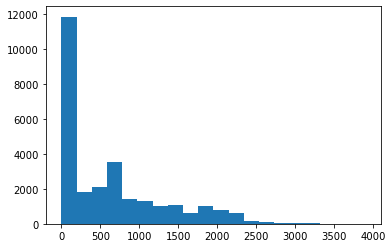

In [404]:
plt.hist(listings.time_since_last_review, bins =20)

In [390]:
listings.time_since_last_review.describe()

count    27548.000000
mean       608.149485
std        678.368362
min         -2.000000
25%         31.000000
50%        397.000000
75%        974.000000
max       3907.000000
Name: time_since_last_review, dtype: float64

In [52]:
listings['time_since_last_review_bin'] = pd.cut(listings.time_since_last_review, 
                               bins=[0, 21, 90, 180, 365, max(listings.time_since_last_review)], 
                               labels=['0-3 weeks', '3-12 weeks', '3-6 months', '6-12 months','1+ year'])


In [408]:
listings.time_since_last_review_bin.value_counts()

1+ year        14055
0-3 weeks       5184
3-12 weeks      4801
6-12 months     1772
3-6 months      1522
Name: time_since_last_review_bin, dtype: int64

In [407]:
listings.time_since_last_review_bin.isnull().value_counts()

False    27334
True      9380
Name: time_since_last_review_bin, dtype: int64

In [53]:
listings.to_pickle("./dummy3.pkl")

In [54]:
listings.time_since_last_review_bin = listings.time_since_last_review_bin.astype('str')
listings['time_since_last_review_bin']=listings['time_since_last_review_bin'].fillna('no reviews')

In [411]:
listings.time_since_last_review_bin.value_counts()

1+ year        14055
no reviews      9380
0-3 weeks       5184
3-12 weeks      4801
6-12 months     1772
3-6 months      1522
Name: time_since_last_review_bin, dtype: int64

In [412]:
listings.time_since_last_review_bin.isnull().value_counts()

False    36714
Name: time_since_last_review_bin, dtype: int64

In [55]:
listings.drop('last_review', axis= 1, inplace = True)

In [414]:
listings.instant_bookable.isnull().value_counts()

False    36714
Name: instant_bookable, dtype: int64

In [56]:
listings.instant_bookable.replace({'f': 0, 't': 1}, inplace=True)

In [416]:
listings.calculated_host_listings_count.isnull().value_counts()

False    36714
Name: calculated_host_listings_count, dtype: int64

In [417]:
listings.calculated_host_listings_count.describe()

count    36714.000000
mean        13.469576
std         45.116414
min          1.000000
25%          1.000000
50%          1.000000
75%          3.000000
max        307.000000
Name: calculated_host_listings_count, dtype: float64

In [418]:
listings.drop(['calculated_host_listings_count_entire_homes',
     'calculated_host_listings_count_private_rooms',
     'calculated_host_listings_count_shared_rooms'],axis =1, inplace =True)

# Features related to rental's availability calendar

In [419]:
listings.availability_30.describe()

count    36714.000000
mean         6.106935
std          9.940232
min          0.000000
25%          0.000000
50%          0.000000
75%          9.000000
max         30.000000
Name: availability_30, dtype: float64

In [420]:
listings.availability_60.describe()

count    36714.000000
mean        15.845372
std         21.355636
min          0.000000
25%          0.000000
50%          0.000000
75%         31.000000
max         60.000000
Name: availability_60, dtype: float64

In [421]:
listings.availability_90.describe()

count    36714.000000
mean        27.772948
std         33.590831
min          0.000000
25%          0.000000
50%          3.000000
75%         60.000000
max         90.000000
Name: availability_90, dtype: float64

In [422]:
listings.availability_365.describe()

count    36714.000000
mean       123.587242
std        138.278906
min          0.000000
25%          0.000000
50%         61.000000
75%        264.000000
max        365.000000
Name: availability_365, dtype: float64

availability_365 is a critical feature for the modeling part. I will drop data points with zero availability in the next 365 days assuming that they are not active listings anymore.

In [423]:
listings.availability_365.value_counts().head() 

0      14723
365     1048
364      487
336      407
179      270
Name: availability_365, dtype: int64

In [333]:
#listings = listings[listings.availability_365 >0]

(array([16966.,  2137.,  2267.,  1382.,  2144.,   800.,  1391.,  1719.,
         2363.,  5545.]),
 array([  0. ,  36.5,  73. , 109.5, 146. , 182.5, 219. , 255.5, 292. ,
        328.5, 365. ]),
 <BarContainer object of 10 artists>)

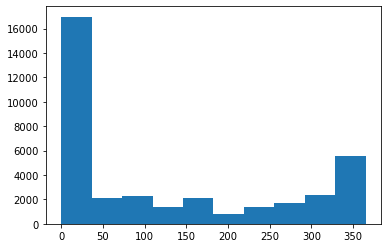

In [424]:
plt.hist(listings.availability_365)

In [425]:
listings.minimum_nights.describe() 

count    36714.000000
mean        22.125674
std         27.945721
min          1.000000
25%          3.000000
50%         30.000000
75%         30.000000
max       1250.000000
Name: minimum_nights, dtype: float64

In [426]:
listings[listings.minimum_nights>365]['id'].count() #drop listings requiring minimum nights more than a year

14

In [59]:
listings.to_pickle("./dummy4.pkl")

In [445]:
#listings = listings[listings.minimum_nights<365]

In [428]:
listings.minimum_nights.describe()

count    36714.000000
mean        22.125674
std         27.945721
min          1.000000
25%          3.000000
50%         30.000000
75%         30.000000
max       1250.000000
Name: minimum_nights, dtype: float64

In [429]:
listings[listings.minimum_nights>30]['id'].count()

1345

# New Feature : Occupancy rate

Occupancy rates are calculated by the number of days that are booked divided by the number of days that the rental is available during a time period.

Airbnb does not to provide exact information about the rentals' occupancy rate. Additionally, the
availability calendar is not useful to calculate the occupancy rate since it does not
differentiate the days booked by guests from the days made unavailable by the host. 
Thus, I will estimate the occupancy rate based on the available on hand data. There are various methods previously been used by researchers and legislative authorities. One estimation method suggested by San Francisco Planning Department <a href="https://commissions.sfplanning.org/cpcpackets/2014-001033PCA.pdf" target="_blank">link</a>
is 


*Estimated Occupancy rates are calculated by multiplying the number of reviews per month by the average length of stay for a visitor staying in a short term rental.  This number is converted to a percentage by annualizing the estimated number of nights the unit is occupied each month and dividing by 365.*

Another one suggested by InsideAirbnb, a modified version of the above is used with the following assumptions:

-A Review Rate of 30% is used to convert reviews to estimated bookings. 

-An average length of stay is configured for each city, and this, multiplied by the estimated bookings for each listing
over a period gives the occupancy rate.


I will estimate the occupancy rate as follows:

***Bookings per month = Number of reviews per month / Percentage of bookings reviewed the listings(i.e. = 0.3)***

***Occupancy per month  Minimum nights required per stay/ Bookings per month***

Assumption: The Listing has the same minimum night required since the first booking. 

The occupancy per month estimation provides a lower bound for the occupancy since the minimum nights per stay is used instead of actual nights per stay. 

***Occupancy rate = Occupancy per month*12/365***


A nominal variable will be formulated for occupancy as high occupancy and low occupancy. The comparative assessment of performance will believed to hinder any deviations caused by the assumption that I make for estimation. 



In [431]:
listings.reviews_per_month.describe()

count    36714.000000
mean         1.089606
std          3.565091
min          0.000000
25%          0.010000
50%          0.190000
75%          1.000000
max        163.190000
Name: reviews_per_month, dtype: float64

In [442]:
np.percentile(listings.reviews_per_month,97.5)

6.843499999999913

In [434]:
listings.minimum_nights.describe()

count    36714.000000
mean        22.125674
std         27.945721
min          1.000000
25%          3.000000
50%         30.000000
75%         30.000000
max       1250.000000
Name: minimum_nights, dtype: float64

In [436]:
np.percentile(listings.minimum_nights,99)

90.0

In [60]:
listings['bookings_per_month'] = listings.reviews_per_month / (0.3)

In [62]:
listings['bookings_per_month'].describe()

count    36714.000000
mean         3.632019
std         11.883636
min          0.000000
25%          0.033333
50%          0.633333
75%          3.333333
max        543.966667
Name: bookings_per_month, dtype: float64

In [63]:
listings['occupancy_per_month'] = listings.bookings_per_month * listings.minimum_nights

In [64]:
listings['occupancy_per_month'].describe()

count    36714.000000
mean        28.372597
std         78.468847
min          0.000000
25%          0.041667
50%          7.933333
75%         26.000000
max       5000.000000
Name: occupancy_per_month, dtype: float64

In [67]:
listings['occupancy_rate'] = listings.occupancy_per_month*12*100/365

In [68]:
listings['occupancy_rate'].describe()

count    36714.000000
mean        93.279772
std        257.979769
min          0.000000
25%          0.136986
50%         26.082192
75%         85.479452
max      16438.356164
Name: occupancy_rate, dtype: float64

<AxesSubplot:>

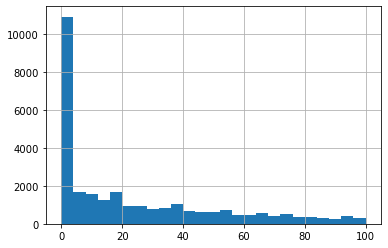

In [70]:
listings['occupancy_rate'].hist(bins=25,range=(0,100))

In [71]:
listings.to_pickle("./NY_airbnb_clean.pkl")